In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt 
pd.set_option('display.max_columns', 50)
from datetime import datetime
from epiweeks import Week
import matplotlib.style as style
style.use('fivethirtyeight')

plt.rcParams["figure.figsize"] = (12,8)

In [2]:
# custom_date_parser = lambda d: datetime.strptime(d , "%Y-%W-%w")

data = pd.read_csv('./Data/train_data_cleaned.csv')

In [3]:
data.sample(5)

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,description,difficulty,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,cooking_tip,meta_tags,percentage_of_local_ingredients,protein_cuts,sales
529,201818,16084,Crispy Scallion Rice Cake,2 person,890.0,99.0,time_level_5,NaN,What's better than sushi rice? Sushi rice flec...,easy,veggie,no_heat,47.0,No,9,no_protein,rice,"rice,other",all_seasons,no_protein,19.0,main,NaN,quick,0.0,no_cut,2831
1453,201906,14104,Spicy Veggie Fried Rice,2 person,700.0,85.0,time_level_4,asian,"Sliced Brussels sprouts, protein-packed edamam...",easy,NaN,NaN,33.0,No,8,NaN,NaN,NaN,NaN,NaN,18.0,NaN,NaN,NaN,0.0,NaN,1369
1204,201847,18566,Turkey Meatloaf & Green Beans,2 person,837.0,65.0,time_level_5,new_american,Meatloaf with mashed potatoes is a guaranteed ...,easy,NaN,NaN,45.0,No,9,NaN,NaN,NaN,NaN,NaN,44.5,NaN,NaN,NaN,0.0,NaN,15689
679,201823,16766,AFC Cheese Ravioli Florentine,z_amazon,840.0,NaN,NaN,NaN,This dish is a textural paradise! Pillowy chee...,easy,veggie,NaN,NaN,No,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4
1062,201841,17977,Garlic-Lime Marinated Steak,2 person,590.0,45.0,time_level_4,new_american,"Here, a simple, but flavorful, lime and garlic...",easy,meat,no_heat,33.0,No,7,beef,potato,meat_and_side,all_seasons,beef,32.0,main,NaN,quick,0.0,steak,22685


In [4]:
# data['year_week'] = data['year_week'].apply(lambda x: str(x).split('-')[-1]) 

In [5]:
data['year_week'] = data['year_week'].astype(str)
data['year'] = data['year_week'].apply(lambda x: x[:4])
data['week'] = data['year_week'].apply(lambda x: x[-2:])

In [6]:
data['year'] = data.year.astype(int)
data['week'] = data.week.astype(int)

In [7]:
data[['year','week']].describe()

,year,week
count,2939.000000,2939.000000
mean,2018.554610,24.052739
std,0.497093,13.459604
min,2018.000000,1.000000
25%,2018.000000,13.000000
50%,2019.000000,24.000000
75%,2019.000000,35.000000
max,2019.000000,52.000000


In [8]:
def year_week(y, w):
    return datetime.strptime(f'{y} {w} 1', '%G %V %u')
data['year_week_ts'] = data.apply(lambda row: year_week(row.year, row.week), axis=1)

In [9]:
data.head()

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,description,difficulty,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,cooking_tip,meta_tags,percentage_of_local_ingredients,protein_cuts,sales,year,week,year_week_ts
0,201801,14919,Shrimp & Broccoli Stir-Fry,2 person,687.0,99.2,time_level_4,asian,"For this dish, once the ingredients are preppe...",easy,fish,optional_heat,18.6,No,7,shellfish,rice,"fish_and_side,stir_fry",all_seasons,shellfish,29.5,main,NaN,healthy_choice,0.0,NaN,3567,2018,1,2018-01-01
1,201801,14920,Caramelized Cabbage Pasta,2 person,779.0,81.3,time_level_4,new_american,Red lentil penne makes this pasta dish a pleas...,easy,veggie,no_heat,38.5,No,5,no_protein,pasta_incl_gnocchi_spatzle,pasta,all_seasons,no_protein,30.0,main,NaN,quick,0.0,no_cut,2532,2018,1,2018-01-01
2,201801,14449,AFC Vegetarian Pad Thai,z_amazon,642.0,92.8,NaN,NaN,Pad Thai is one of our favorite street foods t...,easy,veggie,NaN,25.6,No,10,NaN,NaN,NaN,NaN,NaN,16.2,NaN,NaN,NaN,NaN,NaN,6,2018,1,2018-01-01
3,201801,11963,Shrimp & Broccoli Stir-Fry,family,620.0,93.2,time_level_4,asian,"For this dish, once the ingredients are preppe...",easy,fish,optional_heat,13.7,No,7,shellfish,rice,"fish_and_side,stir_fry",all_seasons,shellfish,28.7,main,NaN,healthy_choice,0.0,NaN,642,2018,1,2018-01-01
4,201801,14914,Chicken & Pasta Soup,family,610.0,67.0,time_level_4,new_american,"We've never met a chicken soup we didn't like,...",easy,meat,no_heat,20.0,No,7,poultry,"sweet_potato,pasta_incl_gnocchi_spatzle",soup,all_seasons,poultry,36.0,main,NaN,healthy_choice,0.0,breast,1492,2018,1,2018-01-01


In [10]:
data[['year_week_ts']].describe()

,year_week_ts
count,2939
unique,96
top,2018-01-29 00:00:00
freq,44
first,2018-01-01 00:00:00
last,2019-10-28 00:00:00


### There is data about 96 weeks in total. For my calculations I have taken the Time Series date to the Beginning of the Week, i.e. Monday.

In [11]:
data.info()

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
RangeIndex: 2939 entries, 0 to 2938
Data columns (total 30 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   year_week                         2939 non-null   object        
 1   recipe_id                         2939 non-null   int64         
 2   recipe_name                       2939 non-null   object        
 3   product_type                      2939 non-null   object        
 4   calories                          2933 non-null   float64       
 5   carbs                             2892 non-null   float64       
 6   cooking_time                      2648 non-null   object        
 7   cuisine                           2106 non-null   object        
 8   description                       2935 non-null   object        
 9   difficulty                        2930 non-null   object        
 10  dish_type                         

In [12]:
data.recipe_id.value_counts()

14449    22
14445    22
14448    22
14446    22
14444    22
         ..
21417     1
14826     1
20989     1
20991     1
36500     1
Name: recipe_id, Length: 1931, dtype: int64

In [13]:
# Lets check the count of sales by year and week
weekly_recipe_sales_df = data.groupby(['year','week'])[['sales']].sum()

In [14]:
weekly_recipe_sales_df.reset_index(inplace=True)

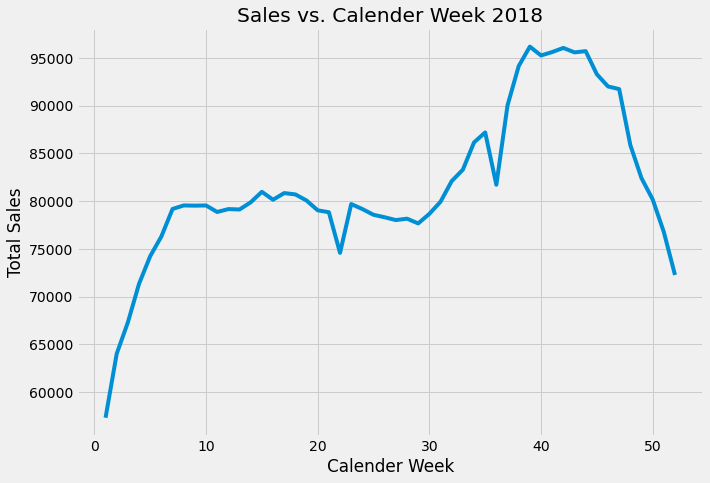

In [15]:
plt.figure(figsize = (10,7))
plt.title('Sales vs. Calender Week 2018')
sns.lineplot(data=weekly_recipe_sales_df[(weekly_recipe_sales_df.year == 2018)], x="week", y="sales")
plt.ylabel('Total Sales')
plt.xlabel('Calender Week')
plt.show()

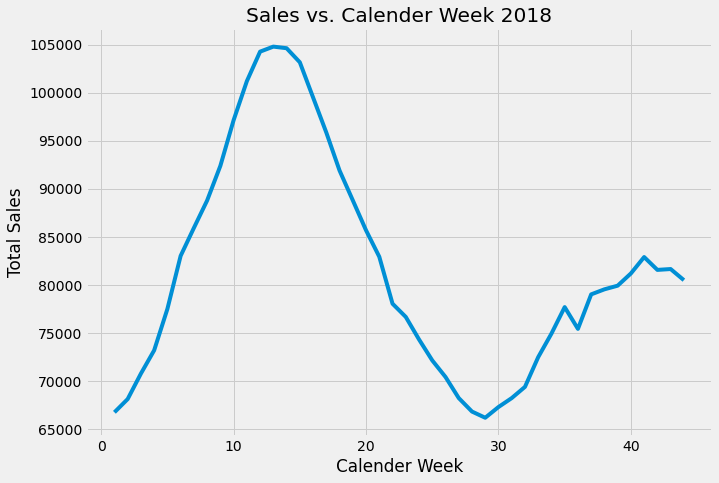

In [16]:
plt.figure(figsize = (10,7))
plt.title('Sales vs. Calender Week 2018')
sns.lineplot(data=weekly_recipe_sales_df[(weekly_recipe_sales_df.year == 2019)], x="week", y="sales")
plt.ylabel('Total Sales')
plt.xlabel('Calender Week')
plt.show()

### The total sales trends are quite different between the years 2018 and 2019

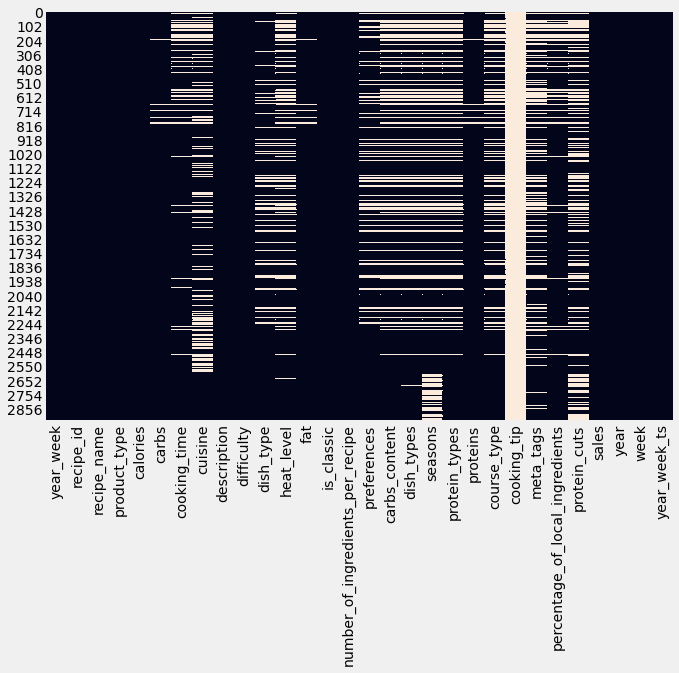

In [17]:
plt.figure(figsize = (10,7))
sns.heatmap(data.isnull(), cbar=False)
plt.show()

In [18]:
data.isna().sum()

year_week                              0
recipe_id                              0
recipe_name                            0
product_type                           0
calories                               6
carbs                                 47
cooking_time                         291
cuisine                              833
description                            4
difficulty                             9
dish_type                            418
heat_level                           716
fat                                   47
is_classic                             0
number_of_ingredients_per_recipe       0
preferences                          513
carbs_content                        701
dish_types                           704
seasons                              925
protein_types                        701
proteins                              47
course_type                          703
cooking_tip                         2939
meta_tags                            870
percentage_of_lo

### There are a lot of columns with varying percentages of missing values in them

In [19]:
# Remove description
data = data.drop('description',axis =1)
# Remove Year as we have the new year_week_ts column
data = data.drop('year',axis =1)


### Handle Missing Values

In [20]:
# Remove Cooking tip column as it is mostly empty
data = data.drop('cooking_tip',axis =1)

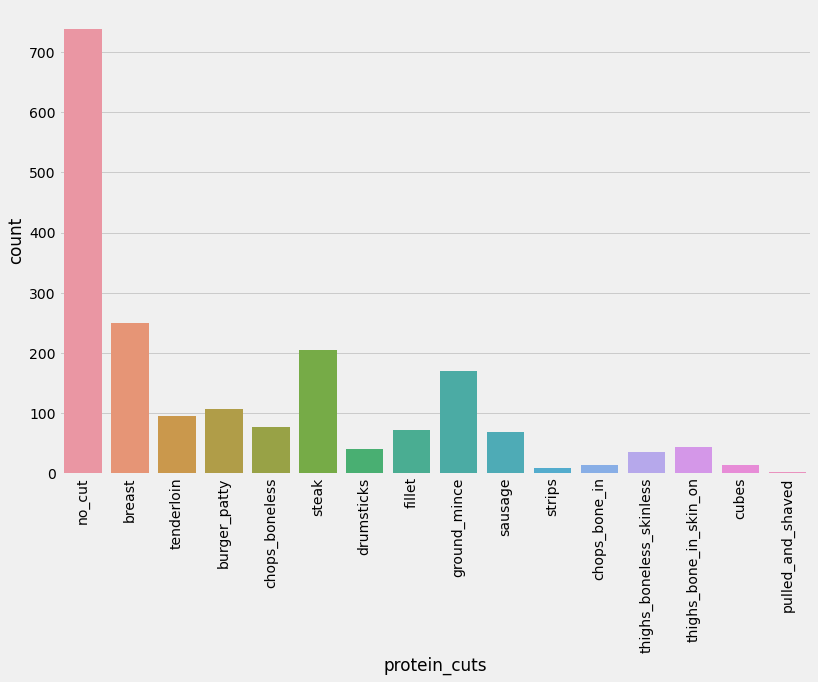

In [21]:
# Lets look at the protien cuts column
# data.protein_cuts.value_counts()
sns.countplot(x = 'protein_cuts',data=data)
plt.xticks(rotation=90)
plt.show()

### Majorly the kind of cut that a recipe has is _no_cuts_. Lets look at some rows which has NaN value in the cuts.

In [22]:
data[data.protein_cuts.isnull()].sample(5)

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,difficulty,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,meta_tags,percentage_of_local_ingredients,protein_cuts,sales,week,year_week_ts
1991,201921,14885,Steak & Mustard Pan Sauce,2 person,800.0,35.0,time_level_4,new_american,easy,NaN,NaN,60.0,No,5,NaN,NaN,NaN,NaN,NaN,32.0,NaN,NaN,0.0,NaN,16871,21,2019-05-20
1447,201906,19479,Seared Steak & Creamed Spinach,2 person,720.0,40.0,time_level_5,new_american,easy,NaN,NaN,44.0,No,7,NaN,NaN,NaN,NaN,NaN,43.0,NaN,NaN,0.0,NaN,17992,6,2019-02-04
544,201818,16046,Chile-Spiced Steak Tacos,add_on,895.0,87.8,NaN,NaN,easy,meat,NaN,34.6,No,9,beef,NaN,NaN,NaN,NaN,56.0,NaN,NaN,NaN,NaN,38,18,2018-04-30
236,201808,14446,AFC Skillet Chicken Parmesan,z_amazon,1043.0,83.6,NaN,NaN,easy,meat,NaN,45.2,No,9,poultry,NaN,NaN,NaN,NaN,56.6,NaN,NaN,NaN,NaN,6,8,2018-02-19
1822,201917,18708,Seared Steak & Salisbury Sauce,family,600.0,60.0,time_level_5,new_american,easy,NaN,NaN,26.0,No,5,NaN,NaN,NaN,NaN,NaN,33.0,NaN,NaN,0.0,NaN,4550,17,2019-04-22


### For the above recipes, clearly a cut is not applicable. So lets fill these NaN values with no_cuts.

In [23]:
data['protein_cuts'] = data.protein_cuts.fillna('no_cut')

### Now lets look at another column _meta_tags_.

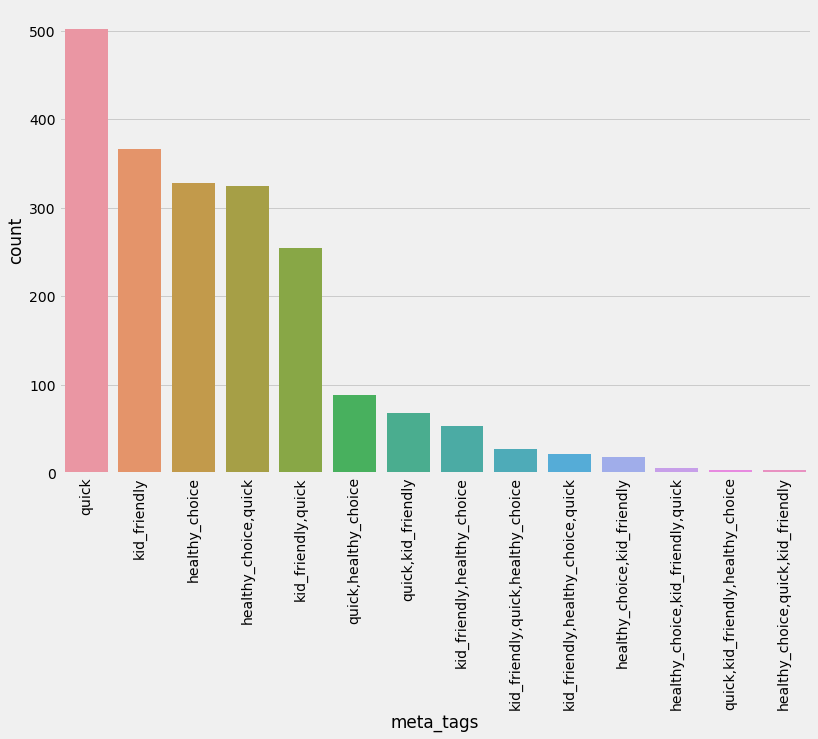

In [24]:
sns.countplot(x = 'meta_tags',data=data,order = data['meta_tags'].value_counts().index)
plt.xticks(rotation=90)
plt.show()

### Most people order something that is Quick, Kid Friendly or is a Healthy Choice. Lets look at some of the columns which do not have a meta tag.

In [25]:
data[data.meta_tags.isnull()].sample(5)

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,difficulty,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,meta_tags,percentage_of_local_ingredients,protein_cuts,sales,week,year_week_ts
2420,201932,21919,Cheesy Sautéed Chicken Thighs,2 person,1040.0,71.0,time_level_4,NaN,easy,NaN,NaN,59.0,No,9,NaN,NaN,NaN,NaN,NaN,53.0,NaN,NaN,0.0,no_cut,621,32,2019-08-05
2281,201928,21623,Indian Butter Chicken\t\t,2 person,720.0,20.0,time_level_4,NaN,easy,NaN,NaN,55.0,No,8,NaN,NaN,NaN,NaN,NaN,41.0,NaN,NaN,0.0,no_cut,1735,28,2019-07-08
169,201806,15381,QVC Mini Meatloaves,z_amazon,750.0,53.1,NaN,NaN,easy,meat,NaN,36.9,No,8,beef,NaN,NaN,NaN,NaN,47.6,NaN,NaN,NaN,no_cut,3,6,2018-02-05
697,201824,16769,AFC Chicken in Peanut Sauce,z_amazon,763.0,NaN,NaN,NaN,easy,meat,NaN,NaN,No,9,poultry,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no_cut,4,24,2018-06-11
2541,201935,22098,Creamy Pepper Pesto Gnocchi,2 person,830.0,122.0,time_level_4,NaN,easy,NaN,NaN,19.0,No,8,NaN,NaN,NaN,NaN,NaN,22.0,NaN,NaN,0.0,no_cut,4212,35,2019-08-26


In [26]:
# Lets check the cooking time for a recipe that is quick.
data[data.meta_tags == 'quick']['cooking_time'].value_counts()

time_level_4    322
time_level_5    147
time_level_3     32
time_level_6      1
Name: cooking_time, dtype: int64

In [27]:
data[data.meta_tags == 'kid_friendly']['cooking_time'].value_counts()

time_level_5    263
time_level_4     89
time_level_6      7
time_level_7      4
time_level_3      3
Name: cooking_time, dtype: int64

In [28]:
data[data.meta_tags == 'healthy_choice']['cooking_time'].value_counts()

time_level_5    165
time_level_4    159
time_level_3      3
time_level_6      1
Name: cooking_time, dtype: int64

### It is not possible to draw any relation between meta_tags and cooking time without knowing further details. Instead I will fill the NaN's with the mode.

In [29]:
data['meta_tags'] = data['meta_tags'].fillna('quick')

### Cuisine

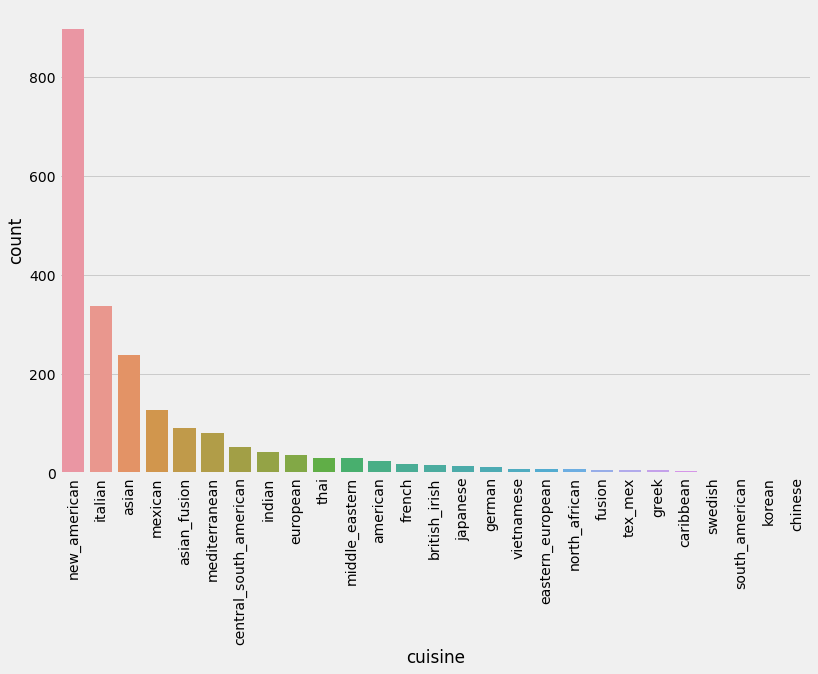

In [30]:
sns.countplot(x = 'cuisine',data=data,order = data['cuisine'].value_counts().index)
plt.xticks(rotation=90)
plt.show()

In [31]:
data['cuisine'] = data['cuisine'].fillna('new_american')

In [32]:
# Drop fat column as only few NaN values are present.
data = data.dropna(subset = ['fat'])

### Dish Type / Heat Level

In [33]:
data[data.dish_type.isnull()].sample(5)

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,difficulty,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,meta_tags,percentage_of_local_ingredients,protein_cuts,sales,week,year_week_ts
600,201820,16254,Stir-Fried Sausage and Rice,family,547.0,71.3,time_level_4,asian_fusion,easy,NaN,NaN,17.2,No,8,NaN,NaN,NaN,NaN,NaN,25.3,NaN,quick,0.0,no_cut,989,20,2018-05-14
2262,201928,21644,Black Bean Veggie Cheeseburger,family,720.0,76.0,time_level_5,new_american,easy,NaN,NaN,36.0,No,10,NaN,NaN,NaN,NaN,NaN,26.0,NaN,quick,0.0,no_cut,113,28,2019-07-08
1326,201901,16254,Stir-Fried Sausage and Rice,family,547.0,71.3,time_level_4,asian_fusion,easy,NaN,NaN,17.2,No,8,NaN,NaN,NaN,NaN,NaN,25.3,NaN,quick,0.0,no_cut,187,1,2018-12-31
1210,201848,16369,Steak au Poivre,2 person,601.0,21.6,time_level_4,french,easy,NaN,NaN,42.8,No,7,NaN,NaN,NaN,NaN,NaN,33.7,NaN,quick,0.0,no_cut,20359,48,2018-11-26
1253,201850,18709,Seared Steak & Salisbury Sauce,2 person,790.0,68.0,time_level_5,new_american,easy,NaN,NaN,43.0,No,5,NaN,NaN,NaN,NaN,NaN,37.0,NaN,quick,0.0,no_cut,18670,50,2018-12-10


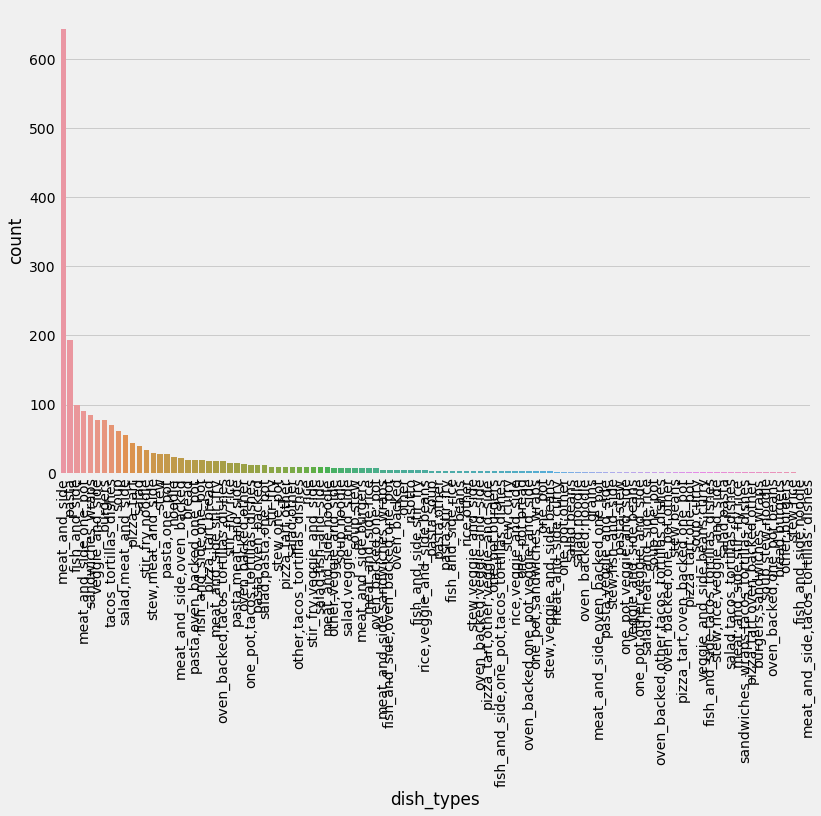

In [34]:
sns.countplot(x = 'dish_types',data=data,order = data['dish_types'].value_counts().index)
plt.xticks(rotation=90)
plt.show()

In [35]:
data['dish_types'] = data['dish_types'].fillna('meat_and_side')

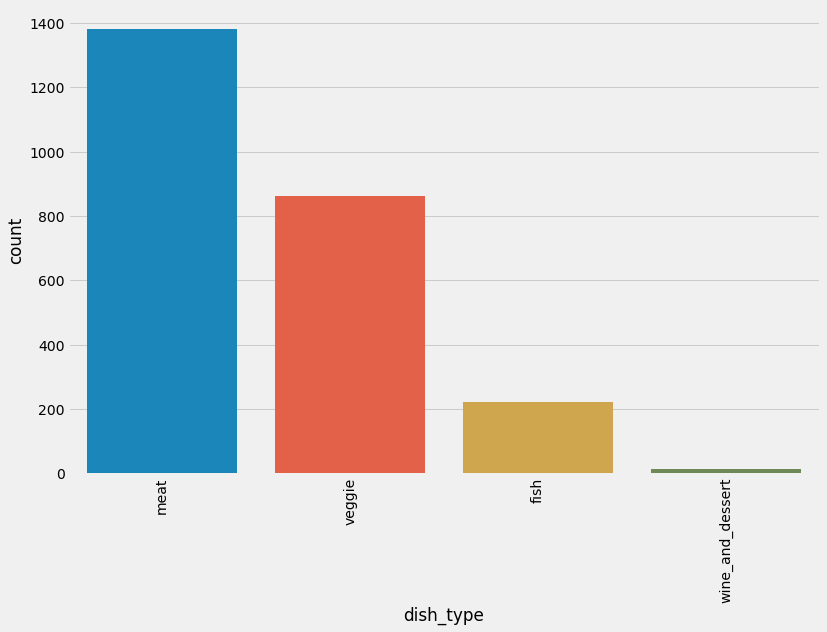

In [36]:
sns.countplot(x = 'dish_type',data=data,order = data['dish_type'].value_counts().index)
plt.xticks(rotation=90)
plt.show()

In [37]:
data['dish_type'] = data['dish_type'].fillna('meat')

In [38]:
data[data.heat_level.isnull()].sample(5)

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,difficulty,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,meta_tags,percentage_of_local_ingredients,protein_cuts,sales,week,year_week_ts
140,201805,15381,QVC Mini Meatloaves,z_amazon,750.0,53.1,NaN,new_american,easy,meat,NaN,36.9,No,8,beef,NaN,meat_and_side,NaN,NaN,47.6,NaN,quick,NaN,no_cut,3,5,2018-01-29
619,201821,16283,Steakhouse Dinner,family,706.0,47.8,time_level_5,new_american,easy,meat,NaN,40.6,No,6,NaN,NaN,meat_and_side,NaN,NaN,39.2,NaN,quick,0.0,no_cut,4276,21,2018-05-21
1437,201906,3097,Restorative Chicken Soup,family,470.0,62.0,time_level_4,new_american,easy,meat,NaN,12.1,No,8,NaN,NaN,meat_and_side,NaN,NaN,30.0,NaN,quick,0.0,no_cut,793,6,2019-02-04
2610,201936,22140,Sticky Asian Drumsticks,2 person,1080.0,94.0,time_level_5,new_american,easy,meat,NaN,36.0,No,8,NaN,NaN,meat_and_side,NaN,NaN,94.0,NaN,quick,0.0,no_cut,773,36,2019-09-02
2450,201932,21942,Grilled Pork Wraps,family,530.0,45.0,NaN,new_american,easy,meat,NaN,23.0,No,10,pork,NaN,meat_and_side,NaN,NaN,37.0,NaN,quick,NaN,no_cut,178,32,2019-08-05


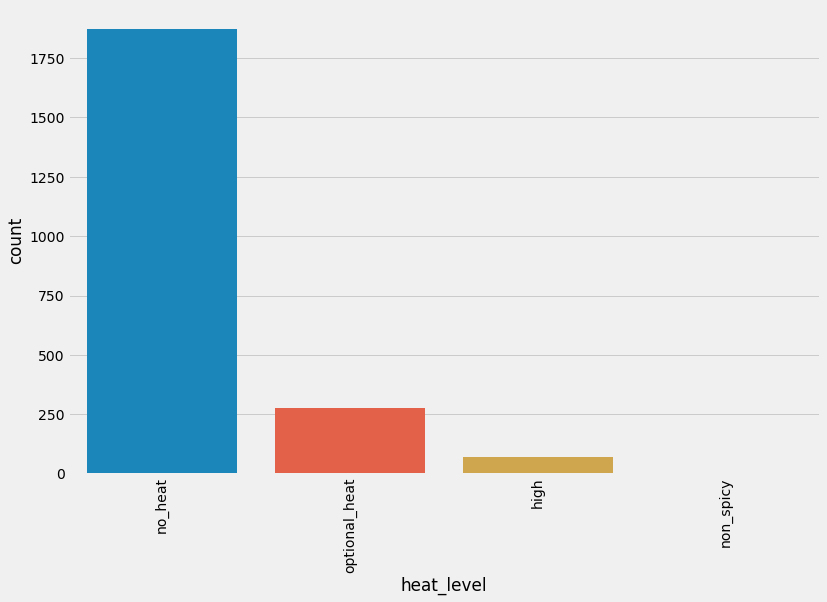

In [39]:
sns.countplot(x = 'heat_level',data=data,order = data['heat_level'].value_counts().index)
plt.xticks(rotation=90)
plt.show()

In [40]:
data['heat_level'] = data['heat_level'].fillna('no_heat')

In [41]:
# Drop Percentage of local ingredients as it does not seem a like a key for ordering a meal
data = data.drop('percentage_of_local_ingredients',axis =1)
data = data.drop('difficulty',axis =1)
data = data[~data.carbs_content.isnull()]

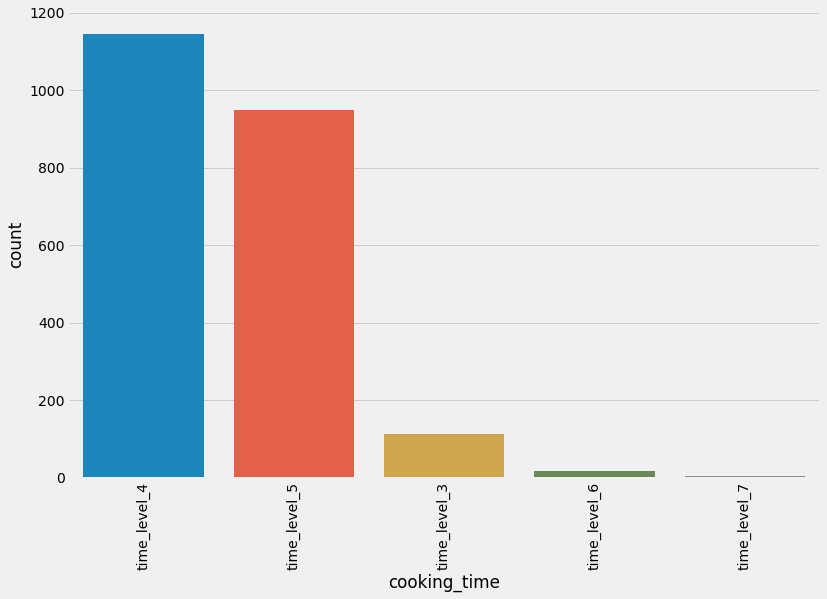

In [42]:
# Cooking time
sns.countplot(x = 'cooking_time',data=data,order = data['cooking_time'].value_counts().index)
plt.xticks(rotation=90)
plt.show()

In [43]:
data['cooking_time'] = data['cooking_time'].fillna('time_level_4')

### Fill the rest of columns with the mode.

In [44]:
data.seasons.value_counts()

all_seasons             1951
summer                    22
autumn                    10
winter                     8
spring                     8
easter                     4
spring,autumn,winter       4
autumn,winter              2
summer,bbq                 2
Name: seasons, dtype: int64

In [45]:
data.course_type.value_counts()

main    2233
Name: course_type, dtype: int64

In [46]:
data['preferences'] = data['preferences'].fillna(data['preferences'].mode()[0])
data['seasons'] = data['seasons'].fillna(data['seasons'].mode()[0])
data['protein_types'] = data['protein_types'].fillna(data['protein_types'].mode()[0])
data['course_type'] = data['course_type'].fillna(data['course_type'].mode()[0])


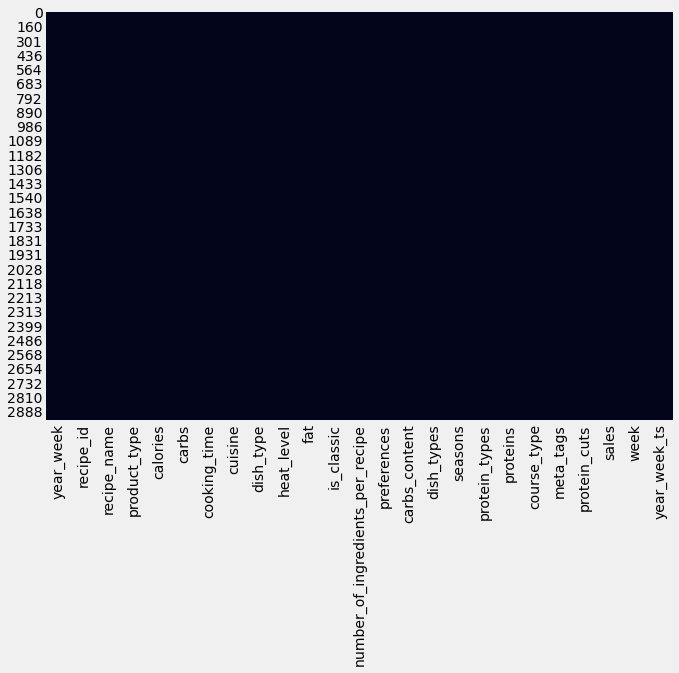

In [47]:
plt.figure(figsize = (10,7))
sns.heatmap(data.isnull(), cbar=False)
plt.show()

### Create some datetime features like no.of German holidays in a particular week, day of the month, Month etc.

In [48]:
import holidays

# Select country
de_holidays = holidays.Germany(years = 2019)
for ptr in de_holidays.items(): 
    print(ptr) 

(datetime.date(2019, 1, 1), &#39;Neujahr&#39;)
(datetime.date(2019, 4, 19), &#39;Karfreitag&#39;)
(datetime.date(2019, 4, 22), &#39;Ostermontag&#39;)
(datetime.date(2019, 5, 1), &#39;Erster Mai&#39;)
(datetime.date(2019, 5, 30), &#39;Christi Himmelfahrt&#39;)
(datetime.date(2019, 6, 10), &#39;Pfingstmontag&#39;)
(datetime.date(2019, 10, 3), &#39;Tag der Deutschen Einheit&#39;)
(datetime.date(2019, 12, 25), &#39;Erster Weihnachtstag&#39;)
(datetime.date(2019, 12, 26), &#39;Zweiter Weihnachtstag&#39;)


In [49]:
de_holidays.get('2018-12-25') 

&#39;Erster Weihnachtstag&#39;

In [50]:
de_holidays.get('2018-01-02')

In [51]:
datelist = pd.date_range('2018-12-20', periods=7).tolist()

In [52]:
count = 0
for date in datelist:
    if de_holidays.get(date):
        count+=1
print(count)

2


In [53]:
def check_no_of_holidays_in_week(week_start_date):
    datelist = pd.date_range(week_start_date, periods=7).tolist()
    count = 0
    for date in datelist:
        if de_holidays.get(date):
            count+=1
    return count

In [54]:
data['no_of_holidays'] = data.year_week_ts.apply(check_no_of_holidays_in_week)

In [55]:
data[data.no_of_holidays > 1].head()

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,meta_tags,protein_cuts,sales,week,year_week_ts,no_of_holidays
1285,201852,18964,Pizza Bianca,2 person,810.0,82.0,time_level_5,italian,veggie,optional_heat,38.0,No,4,dairy,dough,pizza_tart,all_seasons,dairy,36.0,main,kid_friendly,no_cut,1725,52,2018-12-24,2
1286,201852,15224,Spicy Honey Shrimp,2 person,553.0,50.1,time_level_4,new_american,fish,high,28.0,No,5,"shellfish,spicy",grains,fish_and_side,all_seasons,shellfish,26.6,main,quick,no_cut,1449,52,2018-12-24,2
1287,201852,15225,Spicy Honey Shrimp,family,553.0,50.1,time_level_4,new_american,fish,high,28.0,No,5,"shellfish,spicy",grains,fish_and_side,all_seasons,shellfish,26.6,main,quick,no_cut,226,52,2018-12-24,2
1289,201852,16531,Grilled Philly Pork Hoagie,2 person,760.0,68.0,time_level_4,new_american,meat,no_heat,32.0,No,5,pork,bread_and_others,sandwiches_wraps,all_seasons,pork,47.0,main,"kid_friendly,quick",tenderloin,1969,52,2018-12-24,2
1290,201852,16532,Grilled Philly Pork Hoagie,family,710.0,69.0,time_level_4,new_american,meat,no_heat,29.0,No,5,pork,bread_and_others,sandwiches_wraps,all_seasons,pork,46.0,main,"kid_friendly,quick",tenderloin,527,52,2018-12-24,2


In [56]:
# Remove the recipe_name column
data = data.drop(['recipe_name','year_week'],axis=1).reset_index(drop=True)

In [57]:
data.info()

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
RangeIndex: 2235 entries, 0 to 2234
Data columns (total 24 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   recipe_id                         2235 non-null   int64         
 1   product_type                      2235 non-null   object        
 2   calories                          2235 non-null   float64       
 3   carbs                             2235 non-null   float64       
 4   cooking_time                      2235 non-null   object        
 5   cuisine                           2235 non-null   object        
 6   dish_type                         2235 non-null   object        
 7   heat_level                        2235 non-null   object        
 8   fat                               2235 non-null   float64       
 9   is_classic                        2235 non-null   object        
 10  number_of_ingredients_per_recipe  

In [58]:
data.to_csv('./Data/train_data_with_ts.csv',index=False)